## Imports

In [104]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

## Funções auxiliares

In [105]:
def read_ppm(file_path):
    with open(file_path, 'rb') as f:
        header = f.readline().decode()
        if header.strip() != 'P6':
            raise ValueError("O arquivo não está no formato PPM P6.")
        
        file_mode = 'P6'
        dimensions = f.readline().decode()
        while dimensions.startswith('#'):
            dimensions = f.readline().decode()
        width, height = map(int, dimensions.split())
        
        depth = int(f.readline().decode().strip())
        if depth != 255:
            raise ValueError("Profundidade de cor não suportada.")
        
        img_data = np.fromfile(f, dtype=np.uint8)
        img_data = img_data.reshape((height, width, 3))
        
    return img_data

In [106]:
def apply_filter(img_data, filter_weights, filter_size):
    pad_size = filter_size // 2
    padded_img = np.pad(img_data, ((pad_size, pad_size), (pad_size, pad_size), (0, 0)), mode='reflect')
    
    filtered_img = np.zeros_like(img_data)
    for i in range(img_data.shape[0]):
        for j in range(img_data.shape[1]):
            for k in range(img_data.shape[2]):  # Para cada canal de cor
                # Extrair a região da imagem correspondente ao filtro
                region = padded_img[i:i+filter_size, j:j+filter_size, k]
                # Aplicar o filtro (convolução)
                filtered_img[i, j, k] = np.sum(region * filter_weights)
    
    return filtered_img

In [107]:
def save_ppm(file_path, img_data):
    with open(file_path, 'wb') as f:
        header = f'P6\n{img_data.shape[1]} {img_data.shape[0]}\n255\n'
        f.write(header.encode())
        img_data.tofile(f)

In [108]:
def gaussian_kernel(size, sigma):
    ax = np.arange(-size // 2 + 1., size // 2 + 1.)
    xx, yy = np.meshgrid(ax, ax)
    kernel = np.exp(-(xx**2 + yy**2) / (2. * sigma**2))
    kernel = kernel / np.sum(kernel)
    return kernel

## Criação de uma imagem aleatória

### 1. Implemente uma função que receba uma imagem em formato PPM, o tamanho `n` de um filtro espacial com dimensões `n × n` e a matriz com os pesos do filtro, e aplique o filtro com uma convolução, gerando e salvando a imagem resultante no disco em formato PPM. Você não pode usar a OpenCV em nenhum desses passos. As especificações do formato PPM podem ser encontradas aqui: [https://netpbm.sourceforge.net/doc/ppm.html](https://netpbm.sourceforge.net/doc/ppm.html)

In [109]:
input_images = [
    'atividade_1_imgs/cones.ppm',
    'atividade_1_imgs/scene.ppm',
    'atividade_1_imgs/teddy.ppm',
]

- **Imagens utilizadas:**

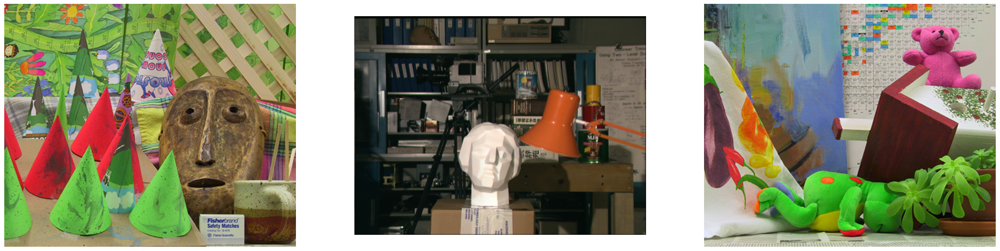

In [110]:
images = []
for image_path in input_images:
    images.append(cv2.imread(image_path))

fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(30, 30))
for ax, img, title in zip(axes.flat, images, input_images):
    ax.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    ax.axis('off')

- **Definição do filtro:**

In [111]:
# kernel Gaussiano 5x5
n = 5
sigma = 2
filter_weights = gaussian_kernel(n, sigma)
filter_weights

array([[0.02324684, 0.03382395, 0.03832756, 0.03382395, 0.02324684],
       [0.03382395, 0.04921356, 0.05576627, 0.04921356, 0.03382395],
       [0.03832756, 0.05576627, 0.06319146, 0.05576627, 0.03832756],
       [0.03382395, 0.04921356, 0.05576627, 0.04921356, 0.03382395],
       [0.02324684, 0.03382395, 0.03832756, 0.03382395, 0.02324684]])

- **Aplicação do filtro:**

In [112]:
output_images = []

for file_path in input_images:
    img_data = read_ppm(file_path)
    filtered_img = apply_filter(img_data, filter_weights, filter_weights.shape[0])
    
    output_file_path = file_path.replace('.ppm', '_filtered.ppm')
    save_ppm(output_file_path, filtered_img)
    output_images.append(output_file_path)
output_images

['atividade_1_imgs/cones_filtered.ppm',
 'atividade_1_imgs/scene_filtered.ppm',
 'atividade_1_imgs/teddy_filtered.ppm']

- **Resultado:**

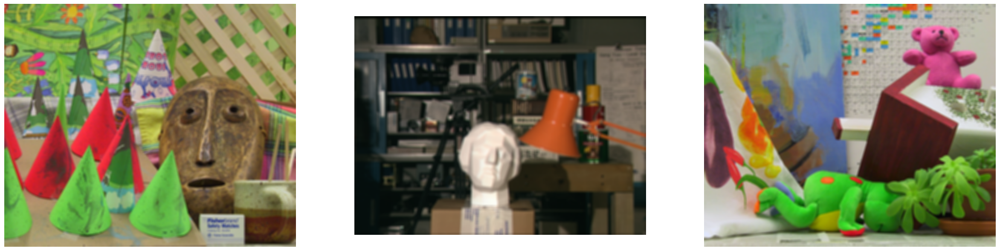

In [113]:
images = []
for image_path in output_images:
    images.append(cv2.imread(image_path))

fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(30, 30))
for ax, img, title in zip(axes.flat, images, output_images):
    ax.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    ax.axis('off')

### 2. Usando a função da questão 1, pesquise um filtro passa-alta e aplique-o em 3 imagens distintas, variando o valor de `n` em 3 unidades em cada imagem. O que acontece quando `n` cresce?

Percebe-se que, ao crescer o valor de $n$ do Filtro Passa-Alta, aumenta também a quantidade de detalhes na imagem resultante, sejam eles componentes de alta frequência, como bordas, por exemplo, o que é uma característica importante do uso de Filtros Passa-Alta numa imagem, o qual é util quando é necessário acentuar os componentes e alta frequência e reduzir as variações suaves de baixa frequência. Porém, notou-se em alguns aspectos o quão ruidosa algumas partes da imagem resultante ficou, já que o Filtro Passa-Alta pode ocasionar uma ampliação de qualquer ruído já presente na imagem.

- Define um filtro passa alta `nxn`:

In [114]:
def high_pass_filter(n):
    delta = np.zeros((n, n))
    delta[n//2, n//2] = 1
    cutoff = 0.5 
    x, y = np.meshgrid(np.linspace(-1, 1, n), np.linspace(-1, 1, n))
    radius = np.sqrt(x**2 + y**2)
    lowpass_kernel = np.exp(-(radius/cutoff)**2)
    lowpass_kernel = lowpass_kernel / np.sum(lowpass_kernel)
    kernel = lowpass_kernel - delta
    return kernel

- **Resultado para `n = 3`**:

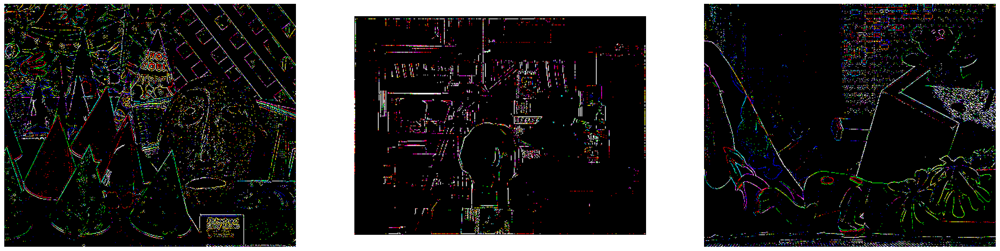

In [115]:
output_images_2a = []

for file_path in input_images:
    img_data = read_ppm(file_path)
    filtered_img = apply_filter(img_data, high_pass_filter(3), high_pass_filter(3).shape[0])
    output_file_path = file_path.replace('.ppm', '_filter_1.ppm')
    save_ppm(output_file_path, filtered_img)
    output_images_2a.append(output_file_path)

images = []
for image_path in output_images_2a:
    images.append(cv2.imread(image_path))

fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(30, 15))
for ax, img, title in zip(axes.flat, images, output_images_2a):
    ax.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    ax.axis('off')

- **Resultado para `n = 6`**:

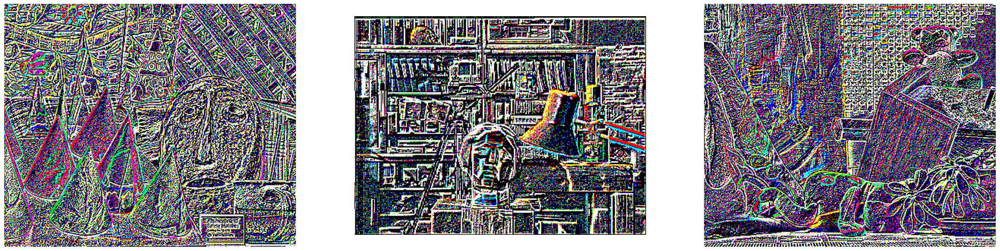

In [116]:
output_images_2b = []

for file_path in input_images:
    img_data = read_ppm(file_path)
    filtered_img = apply_filter(img_data, high_pass_filter(6), high_pass_filter(6).shape[0])
    output_file_path = file_path.replace('.ppm', '_filter_2.ppm')
    save_ppm(output_file_path, filtered_img)
    output_images_2b.append(output_file_path)

images = []
for image_path in output_images_2b:
    images.append(cv2.imread(image_path))

fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(30, 15))
for ax, img, title in zip(axes.flat, images, output_images_2b):
    ax.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    ax.axis('off')

- **Resultado para `n = 9`**:

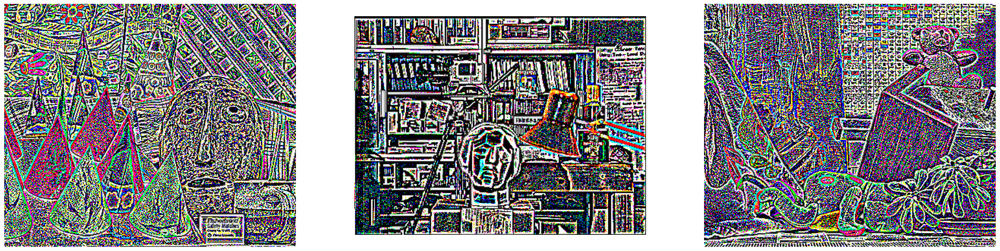

In [117]:
output_images_2c = []

for file_path in input_images:
    img_data = read_ppm(file_path)
    filtered_img = apply_filter(img_data, high_pass_filter(9), high_pass_filter(9).shape[0])
    output_file_path = file_path.replace('.ppm', '_filter_3.ppm')
    save_ppm(output_file_path, filtered_img)
    output_images_2c.append(output_file_path)

images = []
for image_path in output_images_2c:
    images.append(cv2.imread(image_path))

fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(30, 15))
for ax, img, title in zip(axes.flat, images, output_images_2c):
    ax.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    ax.axis('off')

### 3. Usando a função da questão 1, pesquise um filtro passa-baixa e aplique-o em 3 imagens distintas, variando o valor de `n` em 3 unidades em cada imagem. O que acontece quando `n` cresce?

Percebe-se que, ao crescer o valor de $n$ do Filtro Passa-Baixa, aumenta também a suavização e redução de ruído na imagem resultante. Já que o Filtro Passa-Baixa atua reduzindo as componentes de alta frequência e mantedo as de baixa frequência, o que é notório nos exemplos abaixo, em que as imagens ficaram mais borradas e menos granuladas, havendo a perda de detalhes e texturas da imagem original.

- Define um filtro passa baixa `nxn`:

In [118]:
def low_pass_filter(n):
    x, y = np.meshgrid(np.linspace(-1, 1, n), np.linspace(-1, 1, n))
    radius = np.sqrt(x**2 + y**2)
    cutoff = 0.5
    kernel = np.exp(-(radius/cutoff)**2)
    kernel = kernel / np.sum(kernel)
    return kernel

- **Resultado para `n = 3`**:

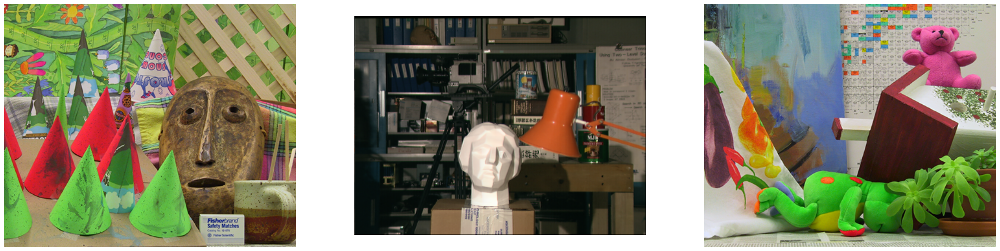

In [119]:
output_images_3a = []

for file_path in input_images:
    img_data = read_ppm(file_path)
    filtered_img = apply_filter(img_data, low_pass_filter(3), low_pass_filter(3).shape[0])
    output_file_path = file_path.replace('.ppm', '_filter_1.ppm')
    save_ppm(output_file_path, filtered_img)
    output_images_3a.append(output_file_path)

images = []
for image_path in output_images_3a:
    images.append(cv2.imread(image_path))

fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(30, 15))
for ax, img, title in zip(axes.flat, images, output_images_3a):
    ax.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    ax.axis('off')

- **Resultado para `n = 6`**:

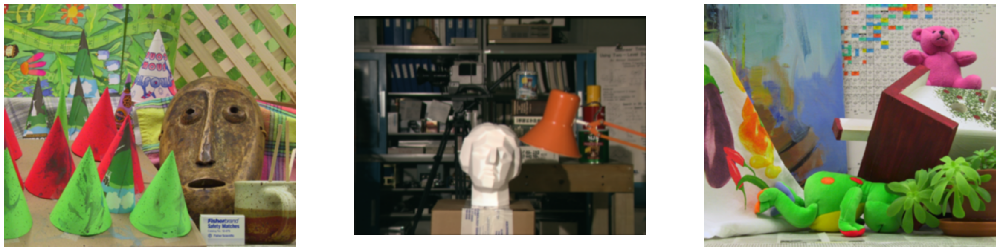

In [120]:
output_images_3b = []

for file_path in input_images:
    img_data = read_ppm(file_path)
    filtered_img = apply_filter(img_data, low_pass_filter(6), low_pass_filter(6).shape[0])
    output_file_path = file_path.replace('.ppm', '_filter_1.ppm')
    save_ppm(output_file_path, filtered_img)
    output_images_3b.append(output_file_path)

images = []
for image_path in output_images_3b:
    images.append(cv2.imread(image_path))

fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(30, 15))
for ax, img, title in zip(axes.flat, images, output_images_3b):
    ax.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    ax.axis('off')

- **Resultado para `n = 9`**:

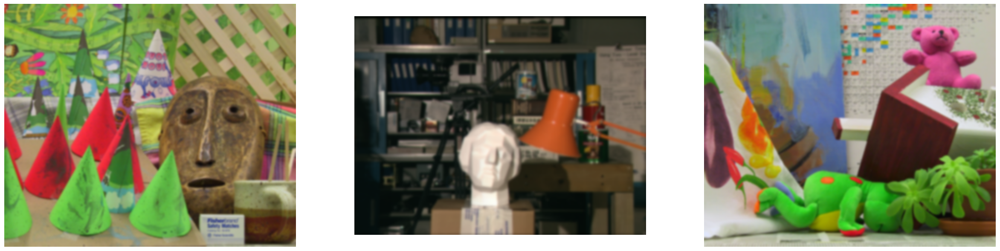

In [121]:
output_images_3c = []

for file_path in input_images:
    img_data = read_ppm(file_path)
    filtered_img = apply_filter(img_data, low_pass_filter(9), low_pass_filter(9).shape[0])
    output_file_path = file_path.replace('.ppm', '_filter_1.ppm')
    save_ppm(output_file_path, filtered_img)
    output_images_3c.append(output_file_path)

images = []
for image_path in output_images_3c:
    images.append(cv2.imread(image_path))

fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(30, 15))
for ax, img, title in zip(axes.flat, images, output_images_3c):
    ax.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    ax.axis('off')

### 4. Um filtro passa-baixa bastante conhecido é o filtro Gaussiano. Através de uma máscara determinada por um desvio padrão $ \sigma $, é possível fazer o que chamamos de suavização gaussiana de uma imagem. Considere o filtro $5 \times 5 $ de desvio padrão unitário abaixo:

$g = \frac{1}{273} \begin{bmatrix}
1 & 4 & 7 & 4 & 1 \\
4 & 16 & 26 & 16 & 4 \\
7 & 26 & 41 & 26 & 7 \\
4 & 16 & 26 & 16 & 4 \\
1 & 4 & 7 & 4 & 1
\end{bmatrix}$


### Crie uma imagem $I $ de dimensões $100 \times 100 $ que contenha um único valor não nulo localizado no centro da imagem. Utilizando o filtro gaussiano acima, calcule e exiba $I * g $, onde $* $ é a notação para o operador de convolução.

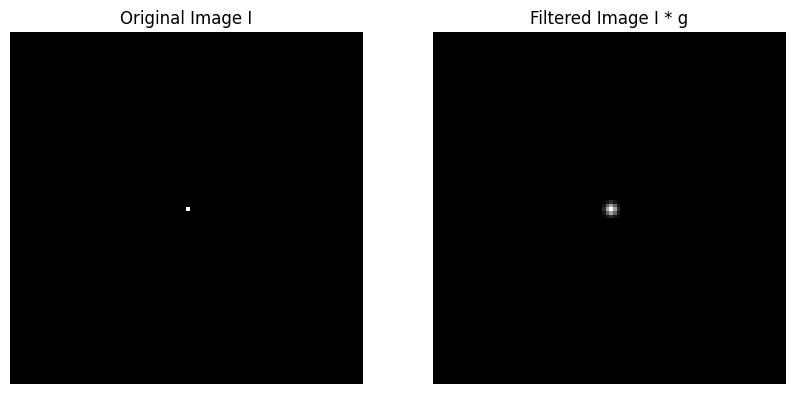

In [122]:
g = np.array([
    [1, 4, 7, 4, 1],
    [4, 16, 26, 16, 4],
    [7, 26, 41, 26, 7],
    [4, 16, 26, 16, 4],
    [1, 4, 7, 4, 1]
]) / 273

I = np.zeros((100, 100))
I[50, 50] = 255

from scipy.ndimage import convolve
I_filtered_custom = convolve(I, g)

# Show the original and filtered images
fig, ax = plt.subplots(1, 2, figsize=(10, 5))
ax[0].imshow(I, cmap='gray')
ax[0].set_title('Original Image I')
ax[0].axis('off')

ax[1].imshow(I_filtered_custom, cmap='gray')
ax[1].set_title('Filtered Image I * g')
ax[1].axis('off')

plt.show()

### 5.Pesquise e implemente um filtro para remoção de ruídos que não possa ser representado com convoluções.

Um exemplo de filtro para remoção de ruído que não utiliza convolução é o filtro mediana. Ao invés de aplicar um kernel sobre a imagem e calcular uma média ponderada dos pixels, o filtro mediana seleciona o valor mediano de uma janela deslizante sobre a imagem. Este método é particularmente bom para remover ruído do tipo "sal e pimenta" sem desfocar as bordas da imagem.

In [123]:
def median_filter(image, kernel_size):
    assert kernel_size % 2 == 1, "Kernel size must be odd."
    
    pad_size = kernel_size // 2
    padded_image = np.pad(image, pad_size, mode='constant', constant_values=0)
    
    filtered_image = np.zeros_like(image)
    
    for i in range(pad_size, image.shape[0] + pad_size):
        for j in range(pad_size, image.shape[1] + pad_size):
            
            window = padded_image[i-pad_size:i+pad_size+1, j-pad_size:j+pad_size+1]
            filtered_image[i-pad_size, j-pad_size] = np.median(window)
    return filtered_image

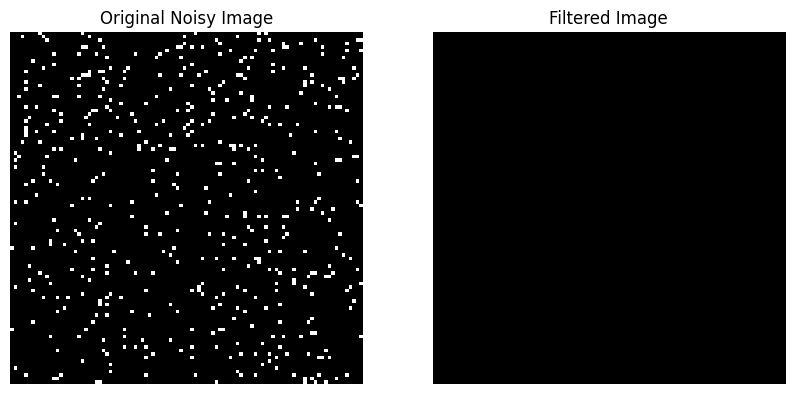

In [124]:
np.random.seed(0)
# Imagem 100x100 com ruído 'sal e pimenta'
image_with_noise = np.random.choice([0, 255], size=(100, 100), p=[0.95, 0.05])

kernel_size_np = 3
filtered_image_np = median_filter(image_with_noise, kernel_size_np)

fig, axes = plt.subplots(1, 2, figsize=(10, 5))
axes[0].imshow(image_with_noise, cmap='gray')
axes[0].set_title('Original Noisy Image')
axes[0].axis('off')

axes[1].imshow(filtered_image_np, cmap='gray')
axes[1].set_title('Filtered Image')
axes[1].axis('off')

plt.show()

### 6. Aplique o detector de canny usando a função `Canny()` da `OpenCV` em uma ou mais imagens de sua escolha. Experimente variar cada um dos parâmetros `threshold1`, `threshold2` e `apertureSize`. Explique com suas pala vras a influência de cada parâmetro no resultado.

In [125]:
input_images = [
    'atividade_1_imgs/cones.ppm',
    'atividade_1_imgs/teddy.ppm',
]

images = []
for image_path in input_images:
    images.append(cv2.imread(image_path))

- **Variando aperture_size:**

In [126]:
t_lower = 100 
t_upper = 250
result = []

aperture_size = 7
result.append(cv2.Canny(images[0], t_lower, t_upper, apertureSize=aperture_size))
result.append(cv2.Canny(images[1], t_lower, t_upper, apertureSize=aperture_size))

aperture_size = 3
result.append(cv2.Canny(images[0], t_lower, t_upper, apertureSize=aperture_size))
result.append(cv2.Canny(images[1], t_lower, t_upper, apertureSize=aperture_size))

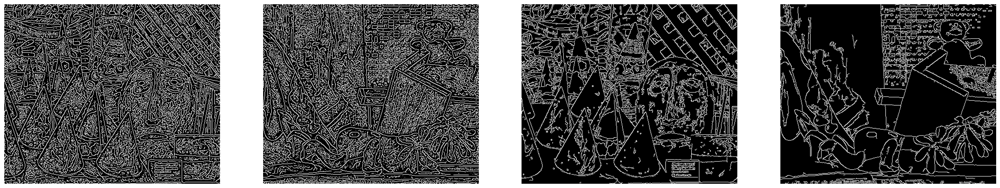

In [127]:
fig, axes = plt.subplots(nrows=1, ncols=4, figsize=(30, 15))
for ax, img in zip(axes.flat, result):
    ax.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    ax.axis('off')

- **Variando t_lower:**

In [128]:
t_lower = 10 
t_upper = 250 
result = []

aperture_size = 3
result.append(cv2.Canny(images[0], t_lower, t_upper, apertureSize=aperture_size))
result.append(cv2.Canny(images[1], t_lower, t_upper, apertureSize=aperture_size))

t_lower = 200 
t_upper = 250 
aperture_size = 3
result.append(cv2.Canny(images[0], t_lower, t_upper, apertureSize=aperture_size))
result.append(cv2.Canny(images[1], t_lower, t_upper, apertureSize=aperture_size))

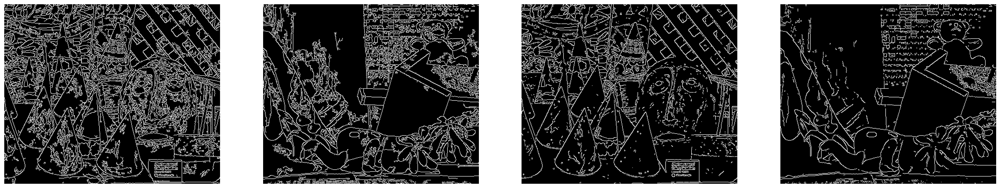

In [129]:
fig, axes = plt.subplots(nrows=1, ncols=4, figsize=(30, 15))
for ax, img in zip(axes.flat, result):
    ax.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    ax.axis('off')

- **Variando t_upper:**

In [130]:
t_lower = 10 
t_upper = 50 
result = []

aperture_size = 3
result.append(cv2.Canny(images[0], t_lower, t_upper, apertureSize=aperture_size))
result.append(cv2.Canny(images[1], t_lower, t_upper, apertureSize=aperture_size))

t_lower = 10 
t_upper = 250 
aperture_size = 3
result.append(cv2.Canny(images[0], t_lower, t_upper, apertureSize=aperture_size))
result.append(cv2.Canny(images[1], t_lower, t_upper, apertureSize=aperture_size))

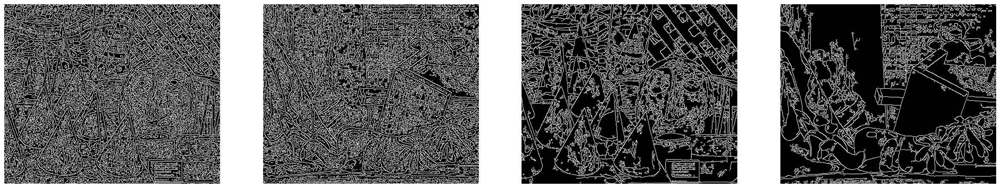

In [131]:
fig, axes = plt.subplots(nrows=1, ncols=4, figsize=(30, 15))
for ax, img in zip(axes.flat, result):
    ax.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    ax.axis('off')



Testando em 2 imagens diferentes e variando os parâmetros, é possível concluir que: 

  - O que estiver acima do valor de t_upper será considerado como aresta.
  - O que estiver abaixo do valor t_lower será desconsirado como aresta.

- Percebemos com a variação no threshold total (lower e upper):

  - Quando utilizado um threshold baixo, temos que o número de arestas tende a aumentar, porém desta forma são calculadas arestas que são irrelevantes.
  - uando utilizado um threshold alto, podemos perder informações importantes, já que as arestas detectadas terão que ter uma intensidade maior.
  
  Logo, o que estiver entre o threshold será analisado e dependendo da sua conectividade será considerado ou não uma aresta. Dito isto, um valor maior de arestas quando a variação de t_lower e t_upper aumenta, e um número menor quando ela diminui. E isso foi visto nos testes em imagens diferentes, a variação nas arestas é visível quando os parâmetros são alterados, correspondendo ao esperado.

  Já em relação ao aperture_size, é possível fazer uso de valores ímpares entre 3 e 7 (por definição do OpenCV), e quanto maior o valor, temos na imagem a detecção mais detalhada, quando o teste com o valor apertureSize = 3 temos uma imagem com uma quantidade de detalhes menor do que quando realizamos o teste com apertureSize = 7.

- Por fim:
  - threshold1: Este é o limiar inferior para o processo. Valores mais baixos resultam na detecção de bordas mais fracas, enquanto valores mais altos possivelmente excluirão as bordas mais sutis.

  - threshold2: Este é o limiar superior para o processo. Este limiar define a força mínima necessária para que uma borda seja considerada "forte" e, portanto, uma verdadeira borda.

  - apertureSize: Este é o tamanho da abertura do filtro usado para encontrar os gradientes da imagem. Um apertureSize maior resultará em bordas mais suavizadas, enquanto um valor menor detectará bordas mais finas.

### 7. Escolha uma imagem interessante e gere uma pirâmide aplicando sucessivamente downsampling 3 vezes com fator 1/2. Faça o mesmo com uma pirâmide gaussiana e compare os resultados. Mostre os resultados de cada pirâmide em uma  ́unica imagem lado a lado, como no slides 20 (vai exigir algumas operações de translação de imagens). Obs.: aqui você pode usar funções do OpenCV.

In [132]:
# Carregando a imagem usando OpenCV
image = cv2.imread('atividade_1_imgs/lena.png')
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

In [133]:
def create_pyramid(image, levels, function):
    pyramid = [image]
    for _ in range(1, levels):
        image = function(image)
        pyramid.append(image)
    return pyramid

def pyramid_layer_down(image):
    return cv2.pyrDown(image)

def pyramid_layer_gaussian(image):
    blurred = cv2.GaussianBlur(image, (5, 5), sigmaX=3)
    return cv2.pyrDown(blurred)

In [134]:
downsampling_pyramid = create_pyramid(image, 4, pyramid_layer_down)
gaussian_pyramid = create_pyramid(image, 4, pyramid_layer_gaussian)

In [135]:
def concatenate_images(images):
    max_width = max(image.shape[1] for image in images)
    concatenated_image = np.zeros((sum(image.shape[0] for image in images), max_width, 3), dtype=np.uint8)
    
    current_y = 0
    for image in images:
        concatenated_image[current_y:current_y+image.shape[0], :image.shape[1]] = image
        current_y += image.shape[0]
    
    return concatenated_image

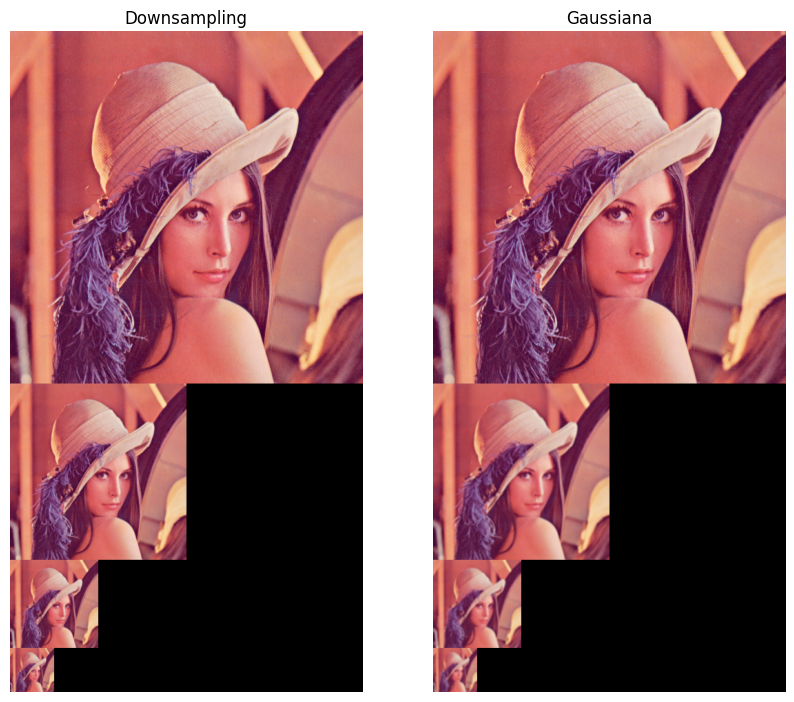

In [136]:
result = []
result.append(concatenate_images(downsampling_pyramid))
result.append(concatenate_images(gaussian_pyramid))

fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(10, 10))
for ax, img, title in zip(axes.flat, result, ["Downsampling", "Gaussiana"]):
    ax.imshow(img)
    ax.set_title(title)
    ax.axis('off')

1. **Downsampling**: A imagem da esquerda mostra os efeitos de reduzir a resolução da imagem sucessivamente sem aplicar um desfoque gaussiano. Com downsampling direto, os detalhes da imagem se tornam mais ásperos e podemos notar artefatos como o aliasing, que é a distorção que ocorre quando a resolução da imagem não é suficiente para capturar os detalhes.

2. **Pirâmide Gaussiana**: Na imagem da direita, cada nível da pirâmide é desfocado antes de ser reduzido pela metade. O filtro gaussiano ajuda a reduzir o aliasing suavizando a imagem. O resultado é uma imagem reduzida com aparência mais suave e com menos artefatos visuais.

### 8. Usando a função da questão 1, crie funções que apliquem filtros para calcular as imagens representando $\frac{\partial f}{\partial x}$, $\frac{\partial f}{\partial y}$ e $|\nabla f|$. Em seguida, implemente o operador de Sobel usando estas imagens como entrada. Exiba cada um desses resultados para três imagens distintas.


In [137]:
input_images = [
    'atividade_1_imgs/cones.ppm',
    'atividade_1_imgs/scene.ppm',
    'atividade_1_imgs/teddy.ppm',
]

images = []
for image_path in input_images:
    images.append(cv2.imread(image_path))

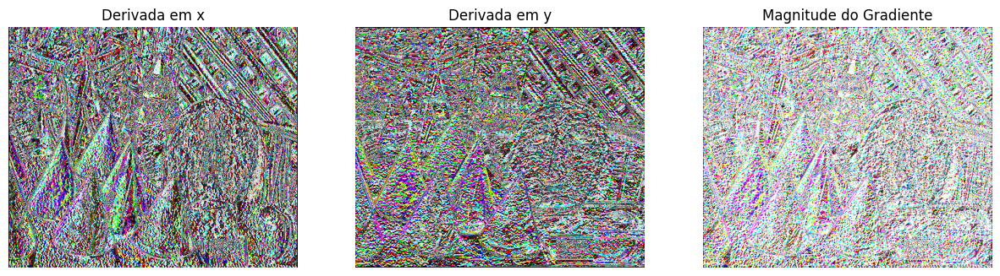

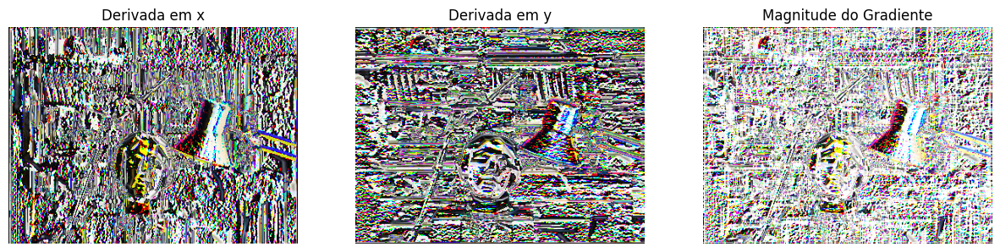

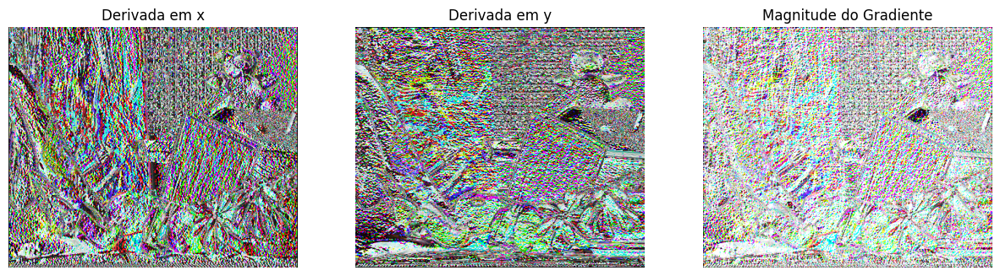

In [138]:
sobel_x = np.array([[-1, 0, 1], [-2, 0, 2], [-1, 0, 1]])
sobel_y = np.array([[-1, -2, -1], [0, 0, 0], [1, 2, 1]])

for image in images:

    grad_x = apply_filter(image, sobel_x, sobel_x.shape[0])
    grad_y = apply_filter(image, sobel_y, sobel_y.shape[0])
    magnitude = np.sqrt(np.square(grad_x.astype(np.uint64)) + np.square(grad_y.astype(np.uint64)))
    magnitude = np.clip(magnitude, 0, 255).astype("uint8")
    
    plt.figure(figsize=(15, 5))
    plt.subplot(131), plt.imshow(grad_x, cmap='gray'), plt.title('Derivada em x'), plt.axis('off')
    plt.subplot(132), plt.imshow(grad_y, cmap='gray'), plt.title('Derivada em y'), plt.axis('off')
    plt.subplot(133), plt.imshow(magnitude, cmap='gray'), plt.title('Magnitude do Gradiente'), plt.axis('off')
    plt.show()